In [3]:
import matplotlib.pyplot as plt
import json

In [5]:
with open('tensorflow_issue_data.json', 'r', encoding='utf-8') as f:
    data = json.load(f)

In [7]:
print(json.dumps(data, indent=4))

[
    {
        "issue_number": "60062",
        "title": "[MSVC]Tensorflow failed to error C2678: binary '==': no operator found which takes a left-hand operand of type 'const _Ty'",
        "state": "closed",
        "created_at": "2023-03-22T08:22:03Z",
        "closed_at": "2025-02-23T02:06:15Z",
        "body": "<details><summary>Click to expand!</summary> \r\n \r\n ### Issue Type\r\n\r\nBug\r\n\r\n### Have you reproduced the bug with TF nightly?\r\n\r\nNo\r\n\r\n### Source\r\n\r\nsource\r\n\r\n### Tensorflow Version\r\n\r\nmaster branch, commit: 48246a6\r\n\r\n### Custom Code\r\n\r\nNo\r\n\r\n### OS Platform and Distribution\r\n\r\nWindows Server 2022\r\n\r\n### Mobile device\r\n\r\n_No response_\r\n\r\n### Python version\r\n\r\n3.9\r\n\r\n### Bazel version\r\n\r\n5.3.0\r\n\r\n### GCC/Compiler version\r\n\r\n_No response_\r\n\r\n### CUDA/cuDNN version\r\n\r\n_No response_\r\n\r\n### GPU model and memory\r\n\r\n_No response_\r\n\r\n### Current Behaviour?\r\n\r\n```shell\r\nCurrent

In [15]:
label_counts = {}

for issue in data:
    labels = issue.get('current_labels', [])
    filtered_labels = [label for label in labels if label.startswith('type:')]
    for label in filtered_labels:
        unique_labels.add(label)
        if label in label_counts:
            label_counts[label] += 1
        else:
            label_counts[label] = 1

label_counts = dict(sorted(label_counts.items(), key=lambda item: item[1], reverse=True))
labels = list(label_counts.keys())

In [16]:
labels

['type:build/install',
 'type:support',
 'type:docs-bug',
 'type:feature',
 'type:others',
 'type:performance',
 'type:bug']

In [18]:
label_counts

{'type:build/install': 99,
 'type:support': 46,
 'type:docs-bug': 18,
 'type:feature': 9,
 'type:others': 7,
 'type:performance': 5,
 'type:bug': 1}

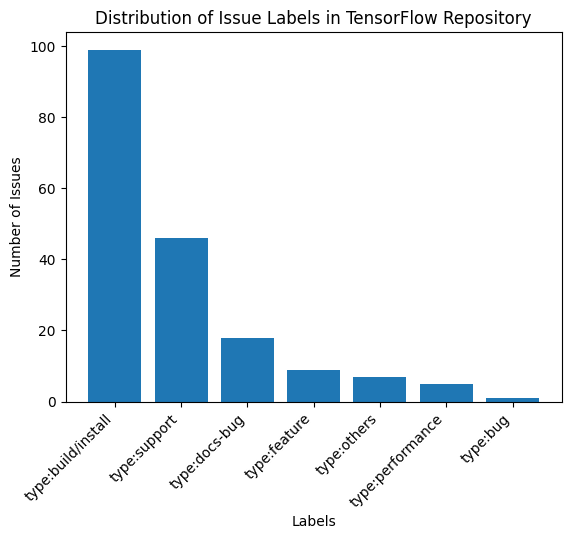

In [17]:
plt.bar(label_counts.keys(), label_counts.values())
plt.xlabel('Labels')
plt.ylabel('Number of Issues') 
plt.title('Distribution of Issue Labels in TensorFlow Repository')
plt.xticks(rotation=45, ha='right')
plt.show()

In [26]:
issues = [data["timeline_data"] for data in data if "timeline_data" in data]

issues_event_labels = {}
for issue in issues:
    event_frame = {}
    for event in issue["timeline_data"]:
        event_type = event.get("event")
        if event_type:
            if event_type not in event_frame:
                event_frame[event_type] = 0
            event_frame[event_type] += 1

    issues_event_labels[issue["issue_number"]] = event_frame

TypeError: list indices must be integers or slices, not str